In [ ]:
!pip install gdown

Exception in thread Thread-5 (attachment_entry):
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/debugpy/server/api.py", line 237, in listen
    sock, _ = endpoints_listener.accept()
              ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/lib/python3.11/socket.py", line 294, in accept
    fd, addr = self._accept()
               ^^^^^^^^^^^^^^
TimeoutError: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/lib/python3.11/threading.py", line 1045, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.11/threading.py", line 982, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.11/dist-packages/google/colab/_debugpy.py", line 52, in attachment_entry
    debugpy.listen(_dap_port)
  File "/usr/local/lib/python3.11/dist-packages/debugpy/public_api.py", line 31, in wrapper
    return wrapped(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^

In [ ]:
import gdown
gdown.download('https://drive.google.com/uc?id=19p3qtGNlc_p12bi3wnbXtELUAR7CE6p8', 'mine', quiet=False)


Downloading...
From (original): https://drive.google.com/uc?id=19p3qtGNlc_p12bi3wnbXtELUAR7CE6p8
From (redirected): https://drive.google.com/uc?id=19p3qtGNlc_p12bi3wnbXtELUAR7CE6p8&confirm=t&uuid=8ccb2c7a-3235-442b-88fe-531c5d25d617
To: /content/mine
100%|██████████| 1.45G/1.45G [00:21<00:00, 66.1MB/s]


'mine'

In [ ]:
!unzip mine -d output_mine
print('done')


Archive:  mine
  inflating: output_mine/from-to-rqd.xlsx  
  inflating: output_mine/label.xlsx  
   creating: output_mine/test-rqd/
  inflating: output_mine/test-rqd/M3-BH3299-1.jpg  
  inflating: output_mine/test-rqd/M3-BH3299-2.jpg  
  inflating: output_mine/test-rqd/M3-BH3299-3.jpg  
  inflating: output_mine/test-rqd/M3-BH3299-4.jpg  
  inflating: output_mine/test-rqd/M3-BH3299-5.jpg  
  inflating: output_mine/test-rqd/M3-BH3299-6.jpg  
  inflating: output_mine/test-rqd/M3-BH3299-7.jpg  
  inflating: output_mine/test-rqd/M3-BH3299-8.jpg  
  inflating: output_mine/test-rqd/M3-BH3299-9.jpg  
  inflating: output_mine/test-rqd/M3-BH3300-1.jpg  
  inflating: output_mine/test-rqd/M3-BH3300-10.jpg  
  inflating: output_mine/test-rqd/M3-BH3300-11.jpg  
  inflating: output_mine/test-rqd/M3-BH3300-12.jpg  
  inflating: output_mine/test-rqd/M3-BH3300-13.jpg  
  inflating: output_mine/test-rqd/M3-BH3300-14.jpg  
  inflating: output_mine/test-rqd/M3-BH3300-15.jpg  
  inflating: output_mine/test-

In [ ]:
!pip install torch_snippets

In [ ]:
from torch_snippets import *
from torchvision import transforms, models, datasets
from torchvision.ops import nms
import torch
from torch import optim
import numpy as np, cv2, pandas as pd, glob, time
import matplotlib.pyplot as plt
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import random
from PIL import Image
import glob

device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
image_root = "/content/output_mine/train"
images_train = Glob(f"{image_root}/*")

random_image = images_train[0]
image = read(random_image)
show(image, title="/M3-BH13250-16.jpg")

In [ ]:
images_train[0]

» /content/output_mine/train/M3-BH13150-35.jpg

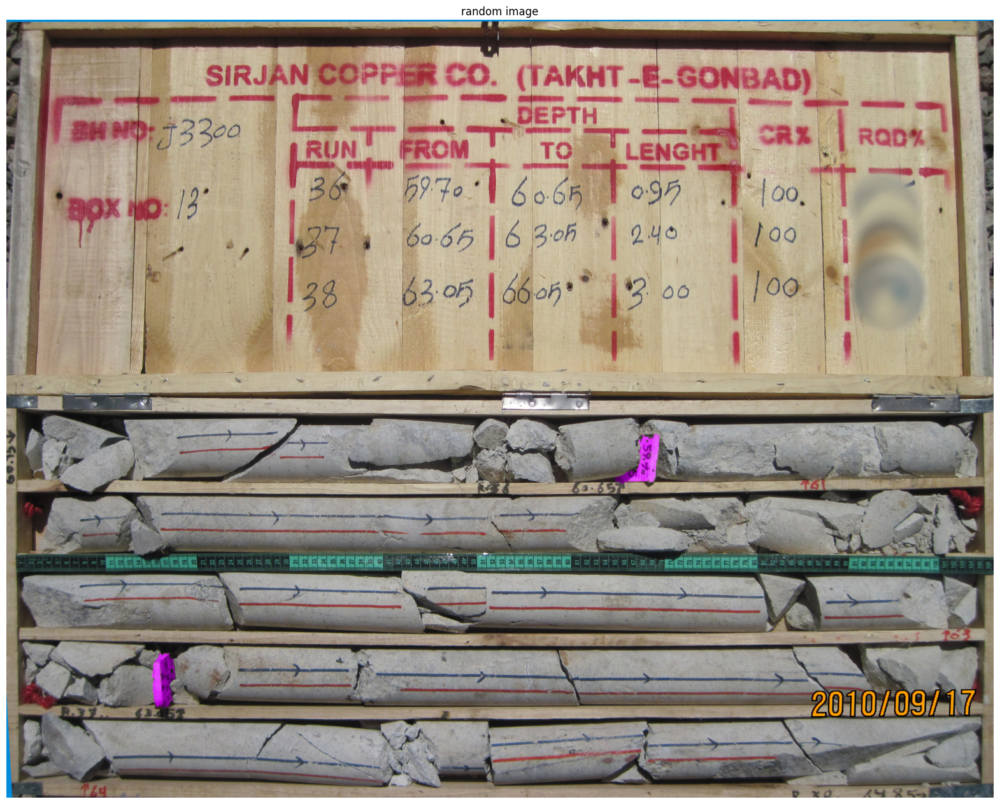

In [ ]:
image_test_root = "/content/output_mine/test-rqd"
images_test = Glob(f"{image_test_root}/*")

random_image = images_test[-1]
image = read(random_image)
show(image, title="random image")

In [ ]:
rqd_xlsx_root = '/content/output_mine/from-to-rqd.xlsx'
df_rqd = pd.read_excel(rqd_xlsx_root)

In [ ]:
label_root = '/content/output_mine/label.xlsx'
df_label = pd.read_excel(label_root)
df_label = df_label.set_index('image_name')
df_label

In [ ]:
len(images_train)

In [ ]:
from pathlib import Path

bh_codes = [path.stem.split('-')[1] for path in images_train]
len(set(bh_codes))

In [ ]:
find_max_run =  df_rqd['to'] - df_rqd['from']
int(max(find_max_run))

In [ ]:
df_rqd[['RunId', 'to']].max()['RunId'][:-4]

In [ ]:
df_rqd = df_rqd.set_index('RunId')
df_rqd

In [ ]:

def process_dataset(df, input_dir, output_dir, padding=25):

    updated_data = []

    os.makedirs(output_dir, exist_ok=True)

    for image_name, group in df.groupby(level=0):
        image_path = os.path.join(input_dir, image_name)
        image = cv2.imread(image_path)

        if image is None:
            print(f"Warning: Unable to read image {image_name}. Skipping...")
            continue

        height, width, _ = image.shape
        half_height = height // 2

        cropped_image = image[half_height:, :]

        padded_image = cv2.copyMakeBorder(cropped_image, 0, padding, 0, 0, cv2.BORDER_CONSTANT, value=(0, 0, 0))

        for _, row in group.iterrows():
            label_name = row["label_name"]
            xmin, ymin, width_bbox, height_bbox = row["xmin"], row["ymin"], row["width"], row["height"]

            if ymin + height_bbox > half_height:
                new_ymin = max(ymin - half_height, 0)
                new_ymax = new_ymin + height_bbox

                if new_ymax > cropped_image.shape[0]:
                    new_ymax = cropped_image.shape[0] + padding


                updated_data.append({
                    "image_name": image_name,
                    "label_name": label_name,
                    "xmin": xmin,
                    "ymin": new_ymin,
                    "width": width_bbox,
                    "height": min(new_ymax - new_ymin, height_bbox),
                    "image_width": width,
                    "image_height": cropped_image.shape[0] + padding,
                })

        output_image_path = os.path.join(output_dir, image_name)
        cv2.imwrite(output_image_path, padded_image)

    updated_df = pd.DataFrame(updated_data)
    updated_df.set_index("image_name", inplace=True)
    return updated_df

In [ ]:
input_dir = "/content/output_mine/train"
output_dir =  "/content/new_train"
df_label_new = process_dataset(df=df_label, input_dir=input_dir, output_dir=output_dir, padding=25)

In [ ]:
df_label_new

,label_name,xmin,ymin,width,height,image_width,image_height
image_name,,,,,,,
M3-BH130-1.jpg,wood,2412,88,152,197,4020,1490
M3-BH130-1.jpg,wood,2917,608,140,220,4020,1490
M3-BH130-1.jpg,wood,3820,103,167,209,4020,1490
M3-BH130-1.jpg,wood,3603,877,201,186,4020,1490
M3-BH130-1.jpg,wood,1676,1249,159,171,4020,1490
...,...,...,...,...,...,...,...
M3-BH300-9.JPG,+10cm rock,2766,1327,507,225,4147,1667
M3-BH300-9.JPG,+10cm rock,3668,1293,398,240,4147,1667
M3-BH300-9.JPG,wood,949,90,109,213,4147,1667


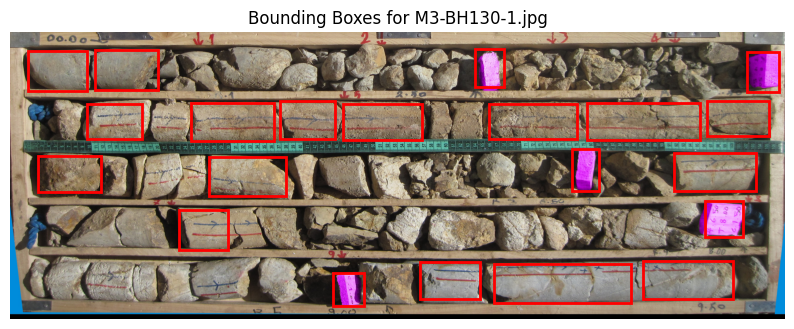

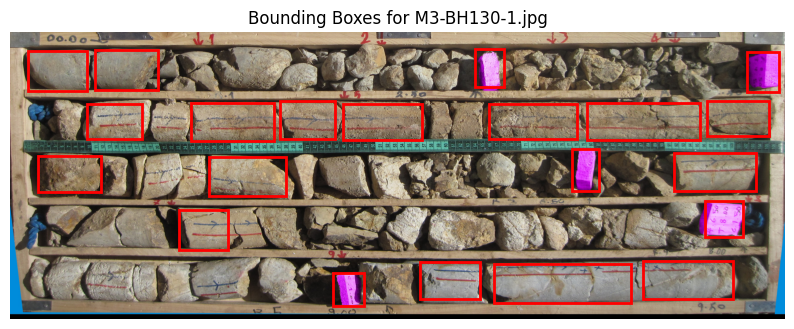

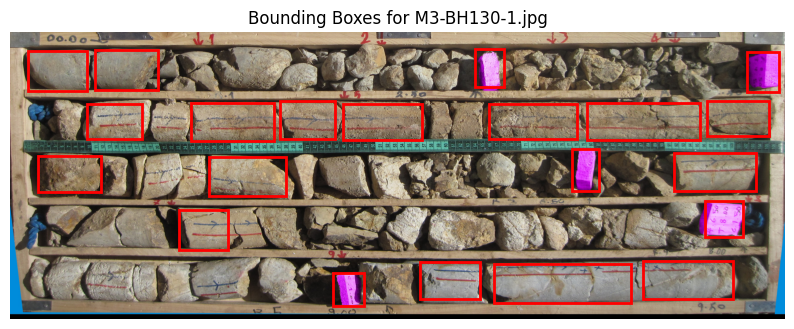

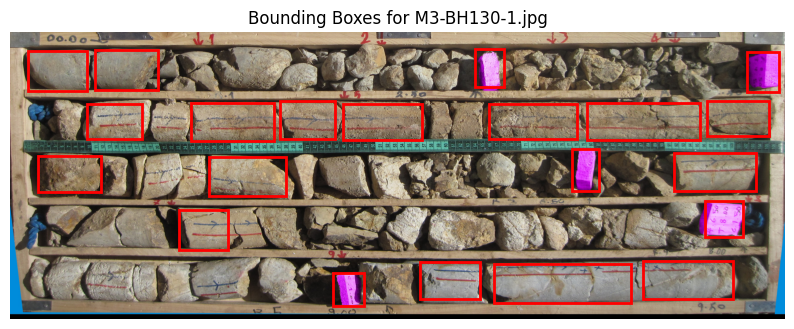

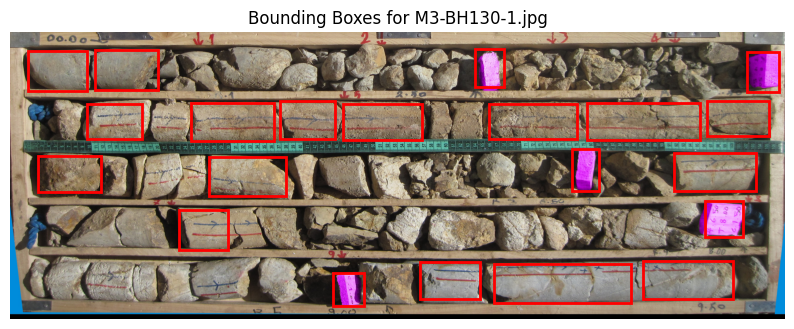

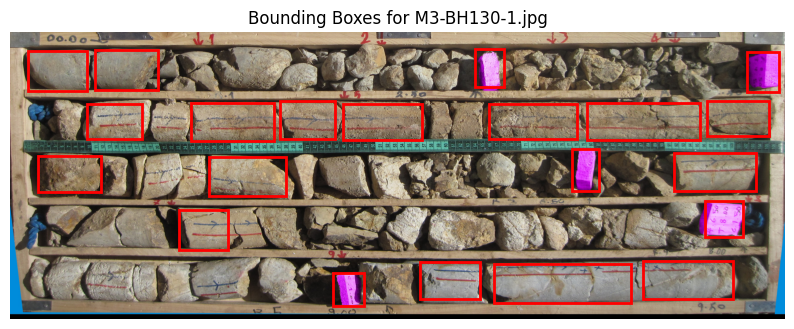

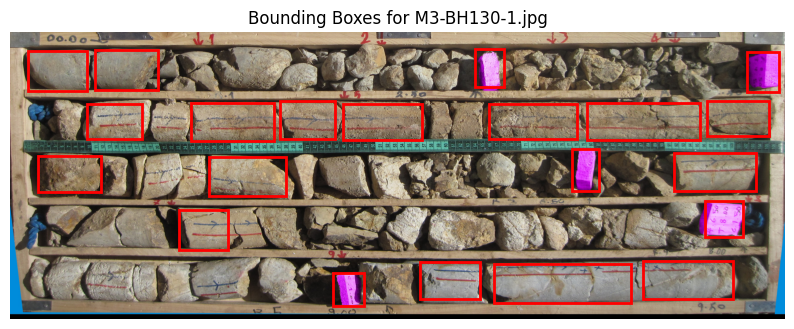

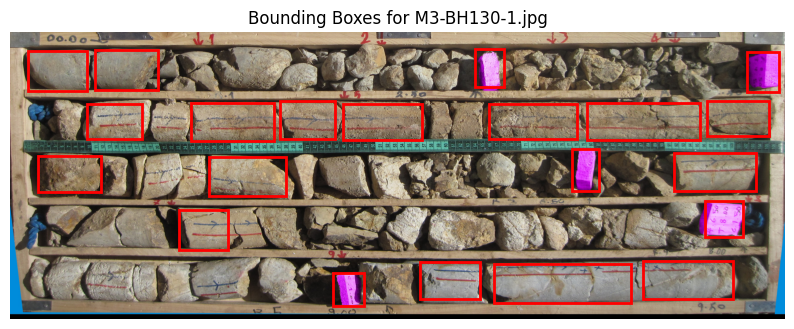

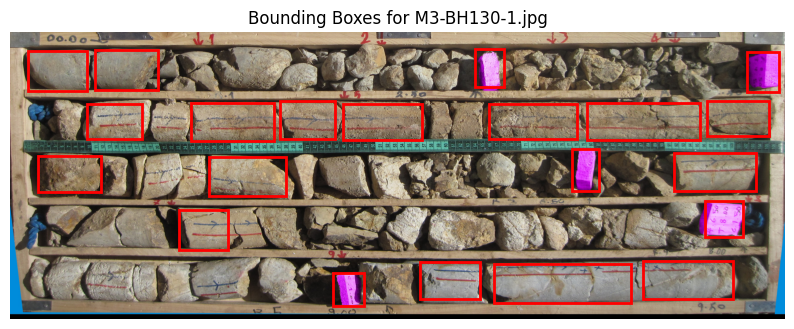

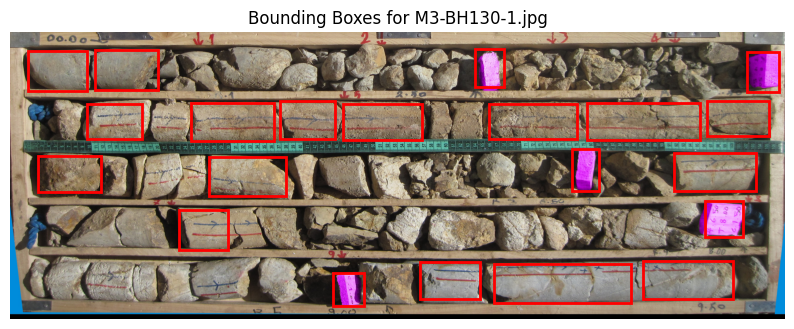

In [ ]:
image_folder = "/content/new_train"

image_names = df_label_new.index[:10]

for image_name in image_names:
    image_path = os.path.join(image_folder, image_name)
    image = Image.open(image_path)

    bboxes = df_label_new[df_label_new.index == image_name]

    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    ax = plt.gca()

    for _, row in bboxes.iterrows():
        xmin, ymin, width, height = row["xmin"], row["ymin"], row["width"], row["height"]
        ax.add_patch(plt.Rectangle((xmin, ymin), width, height, fill=False, edgecolor='red', linewidth=2))

    plt.title(f"Bounding Boxes for {image_name}")
    plt.axis('off')
    plt.show()

In [ ]:
image_dir = '/content/new_train'

def rotate_image_180(image_path, boxes):

    image = cv2.imread(image_path)

    rotated_image = cv2.rotate(image, cv2.ROTATE_180)

    rotated_bboxes = []
    for x, y, w, h in boxes:
        xmin, ymin = x, y
        xmax = xmin + w
        ymax = ymin + h

        new_xmin = image.shape[1] - xmax
        new_ymin = image.shape[0] - ymax
        new_xmax = image.shape[1] - xmin
        new_ymax = image.shape[0] - ymin

        new_w = new_xmax - new_xmin
        new_h = new_ymax - new_ymin

        rotated_bboxes.append((new_xmin, new_ymin, new_w, new_h))

    return rotated_image, rotated_bboxes

rotated_image_dir = '/content/rotated_images180'
os.makedirs(rotated_image_dir, exist_ok=True)

rotated_images = []
rotated_boxes = []

for index, row in df_label_new.iterrows():
    image_name = index
    image_path = os.path.join(image_dir, image_name)
    boxes = [(row['xmin'], row['ymin'], row['width'], row['height'])]

    rotated_image, rotated_bboxes = rotate_image_180(image_path, boxes)

    new_image_name = f"{os.path.splitext(image_name)[0]}_rotated{os.path.splitext(image_name)[1]}"
    new_image_path = os.path.join(rotated_image_dir, new_image_name)

    cv2.imwrite(new_image_path, rotated_image)

    rotated_images.append(new_image_name)

    for bbox in rotated_bboxes:
        xmin, ymin, width, height = bbox
        rotated_boxes.append([row['label_name'], xmin, ymin, width, height, row['image_width'], row['image_height']])

df_rotated180 = pd.DataFrame(rotated_boxes, columns=['label_name', 'xmin', 'ymin', 'width', 'height', 'image_width', 'image_height'])
df_rotated180['image_name'] = rotated_images
df_rotated180.set_index('image_name', inplace=True)

In [ ]:
df_rotated180

,label_name,xmin,ymin,width,height,image_width,image_height
image_name,,,,,,,
M3-BH130-1_rotated.jpg,wood,1456,1205,152,197,4020,1490
M3-BH130-1_rotated.jpg,wood,963,662,140,220,4020,1490
M3-BH130-1_rotated.jpg,wood,33,1178,167,209,4020,1490
M3-BH130-1_rotated.jpg,wood,216,427,201,186,4020,1490
M3-BH130-1_rotated.jpg,wood,2185,70,159,171,4020,1490
...,...,...,...,...,...,...,...
M3-BH300-9_rotated.JPG,+10cm rock,874,115,507,225,4147,1667
M3-BH300-9_rotated.JPG,+10cm rock,81,134,398,240,4147,1667
M3-BH300-9_rotated.JPG,wood,3089,1364,109,213,4147,1667


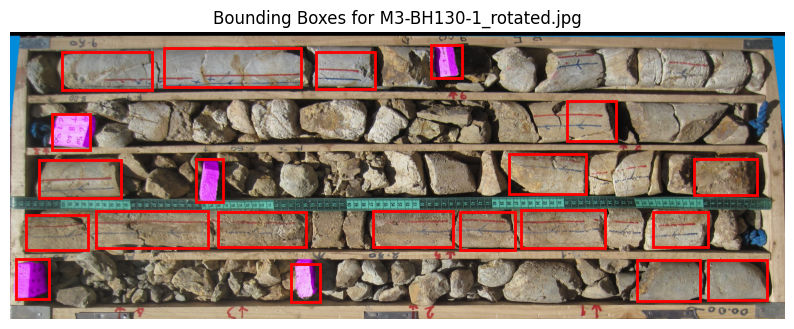

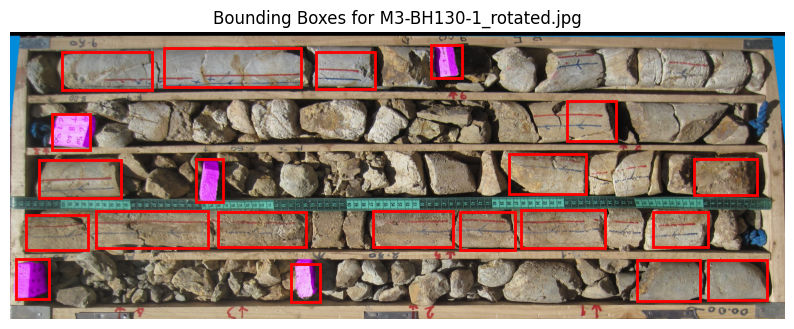

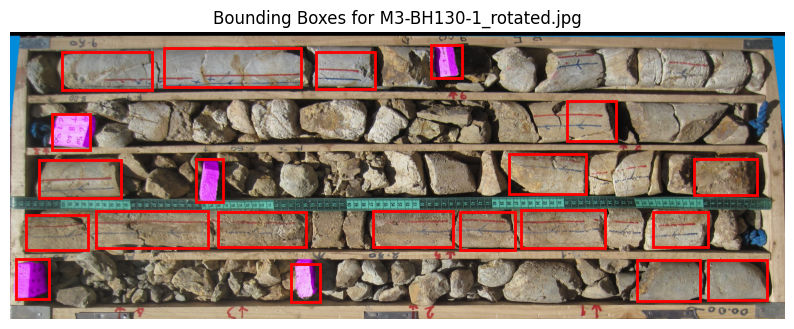

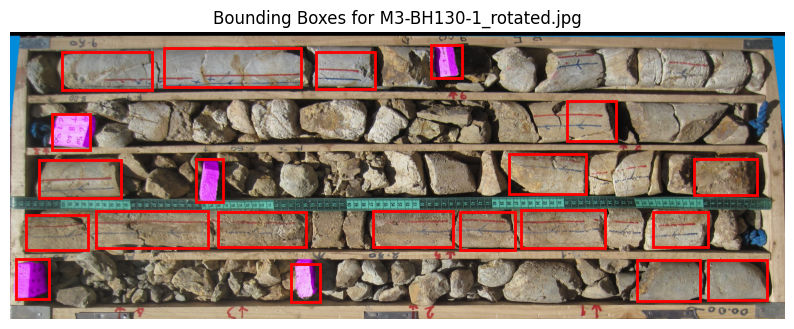

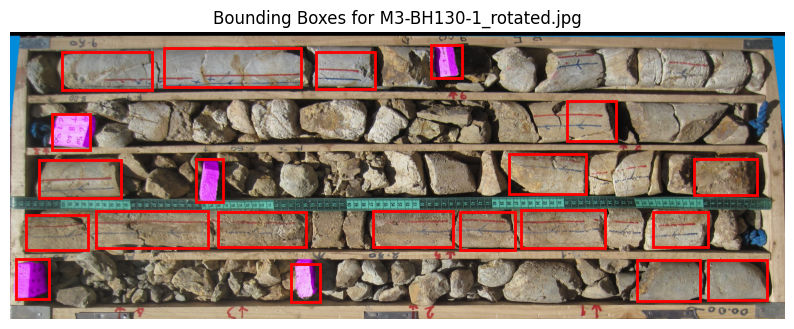

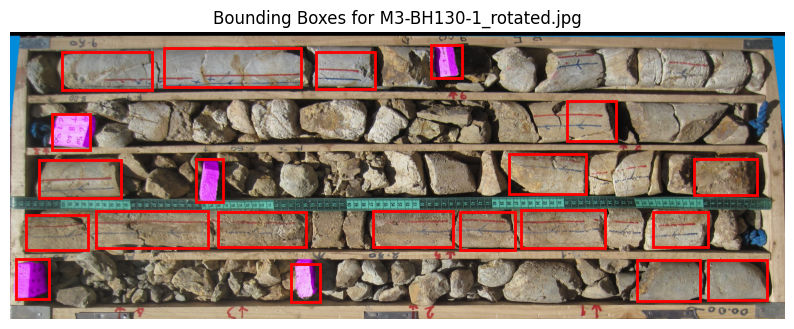

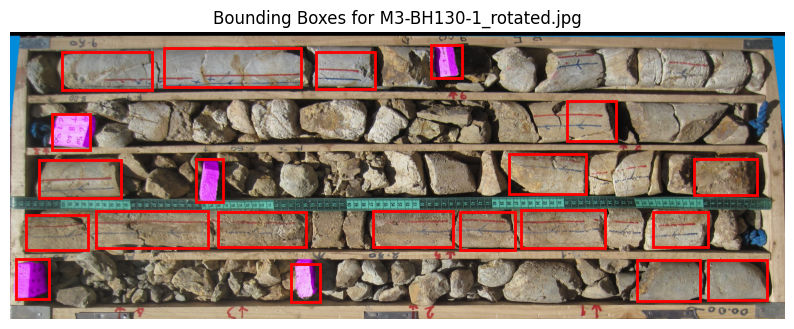

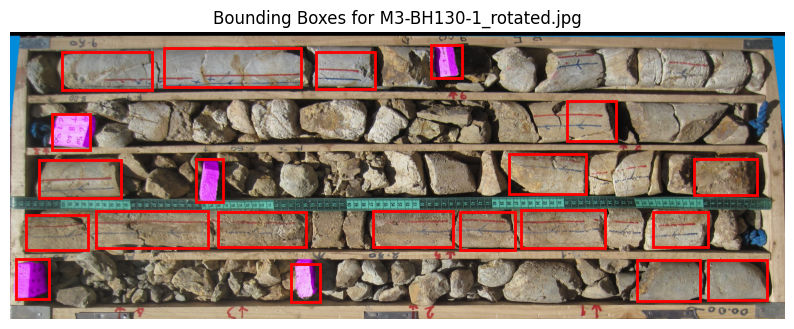

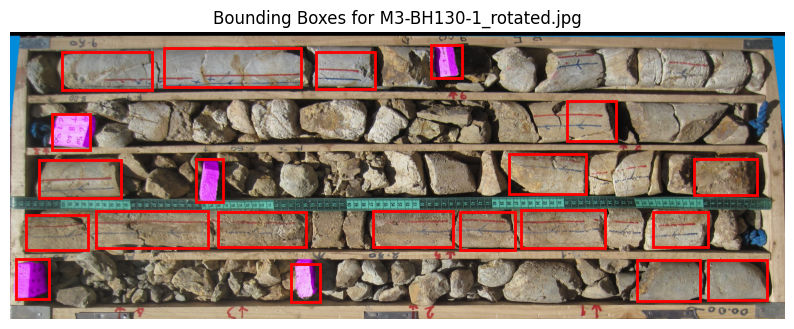

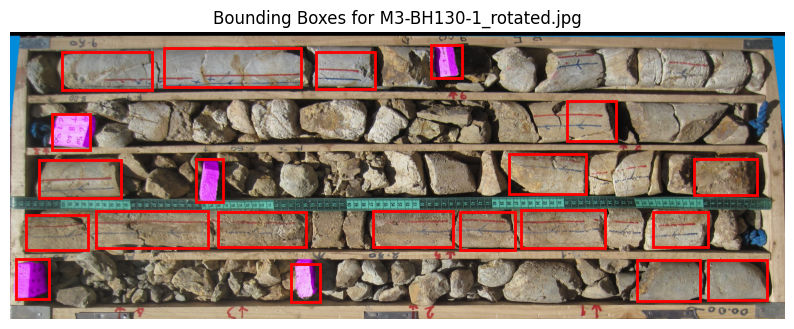

In [ ]:
image_folder = "/content/rotated_images180"

image_names = df_rotated180.index[:10]

for image_name in image_names:
    image_path = os.path.join(image_folder, image_name)
    image = Image.open(image_path)

    bboxes = df_rotated180[df_rotated180.index == image_name]

    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    ax = plt.gca()

    for _, row in bboxes.iterrows():
        xmin, ymin, width, height = row["xmin"], row["ymin"], row["width"], row["height"]
        ax.add_patch(plt.Rectangle((xmin, ymin), width, height, fill=False, edgecolor='red', linewidth=2))

    plt.title(f"Bounding Boxes for {image_name}")
    plt.axis('off')
    plt.show()

In [ ]:
folder_path = '/content/rotated_images180'

image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif'))]

num_images = len(image_files)
num_images

156

In [ ]:
folder_path = '/content/new_train'

image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif'))]

num_images = len(image_files)
num_images

156

In [ ]:
import shutil

folder_path1 = '/content/new_train'
folder_path2 = '/content/rotated_images180'
combined_folder = '/content/combined_images'


os.makedirs(combined_folder, exist_ok=True)

for image_name in os.listdir(folder_path1):
    image_path = os.path.join(folder_path1, image_name)
    new_path = os.path.join(combined_folder, image_name)
    shutil.copy(image_path, new_path)

for image_name in os.listdir(folder_path2):
    image_path = os.path.join(folder_path2, image_name)
    new_path = os.path.join(combined_folder, image_name)
    shutil.copy(image_path, new_path)

df_combined = pd.concat([df_label_new, df_rotated180])

In [ ]:
df_combined

,label_name,xmin,ymin,width,height,image_width,image_height
image_name,,,,,,,
M3-BH130-1.jpg,wood,2412,88,152,197,4020,1490
M3-BH130-1.jpg,wood,2917,608,140,220,4020,1490
M3-BH130-1.jpg,wood,3820,103,167,209,4020,1490
M3-BH130-1.jpg,wood,3603,877,201,186,4020,1490
M3-BH130-1.jpg,wood,1676,1249,159,171,4020,1490
...,...,...,...,...,...,...,...
M3-BH300-9_rotated.JPG,+10cm rock,874,115,507,225,4147,1667
M3-BH300-9_rotated.JPG,+10cm rock,81,134,398,240,4147,1667
M3-BH300-9_rotated.JPG,wood,3089,1364,109,213,4147,1667


In [ ]:
folder_path = '/content/combined_images'

image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif'))]

num_images = len(image_files)
num_images

312

In [ ]:
image_dir = '/content/combined_images'
output_dir = '/content/resized_images'
os.makedirs(output_dir, exist_ok=True)


target_size = (640, 640)

def resize_with_letterbox(image, target_size):
    h, w = image.shape[:2]
    scale = min(target_size[0] / w, target_size[1] / h)
    nw, nh = int(w * scale), int(h * scale)
    resized_image = cv2.resize(image, (nw, nh), interpolation=cv2.INTER_LINEAR)

    top = (target_size[1] - nh) // 2
    bottom = target_size[1] - nh - top
    left = (target_size[0] - nw) // 2
    right = target_size[0] - nw - left
    padded_image = cv2.copyMakeBorder(resized_image, top, bottom, left, right, cv2.BORDER_CONSTANT, value=(0, 0, 0))
    return padded_image, scale, top, left

new_records = []
for image_name, row in df_combined.iterrows():
    image_path = os.path.join(image_dir, image_name)
    image = cv2.imread(image_path)

    if image is not None:
        resized_image, scale, top, left = resize_with_letterbox(image, target_size)

        output_path = os.path.join(output_dir, image_name)
        cv2.imwrite(output_path, resized_image)

        xmin = int(row['xmin'] * scale + left)
        ymin = int(row['ymin'] * scale + top)
        xmax = int((row['xmin'] + row['width']) * scale + left)
        ymax = int((row['ymin'] + row['height']) * scale + top)
        width = xmax - xmin
        height = ymax - ymin

        new_records.append({
            'label_name': row['label_name'],
            'xmin': xmin,
            'ymin': ymin,
            'width': width,
            'height': height,
            'image_width': target_size[0],
            'image_height': target_size[1],
            'image_name': image_name
        })
    else:
        print(f"تصویر {image_name} یافت نشد.")

df_resized = pd.DataFrame(new_records).set_index('image_name')

In [ ]:
df_resized

,label_name,xmin,ymin,width,height,image_width,image_height
image_name,,,,,,,
M3-BH130-1.jpg,wood,384,215,24,31,640,640
M3-BH130-1.jpg,wood,464,297,22,35,640,640
M3-BH130-1.jpg,wood,608,217,26,33,640,640
M3-BH130-1.jpg,wood,573,340,32,30,640,640
M3-BH130-1.jpg,wood,266,399,26,28,640,640
...,...,...,...,...,...,...,...
M3-BH300-9_rotated.JPG,+10cm rock,134,208,79,35,640,640
M3-BH300-9_rotated.JPG,+10cm rock,12,211,61,37,640,640
M3-BH300-9_rotated.JPG,wood,476,401,17,33,640,640


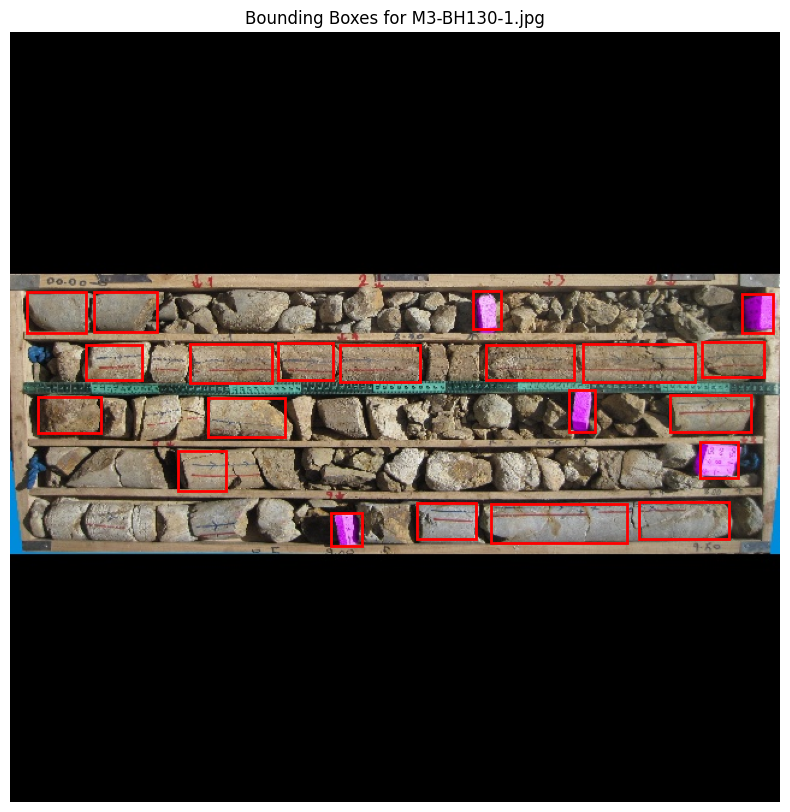

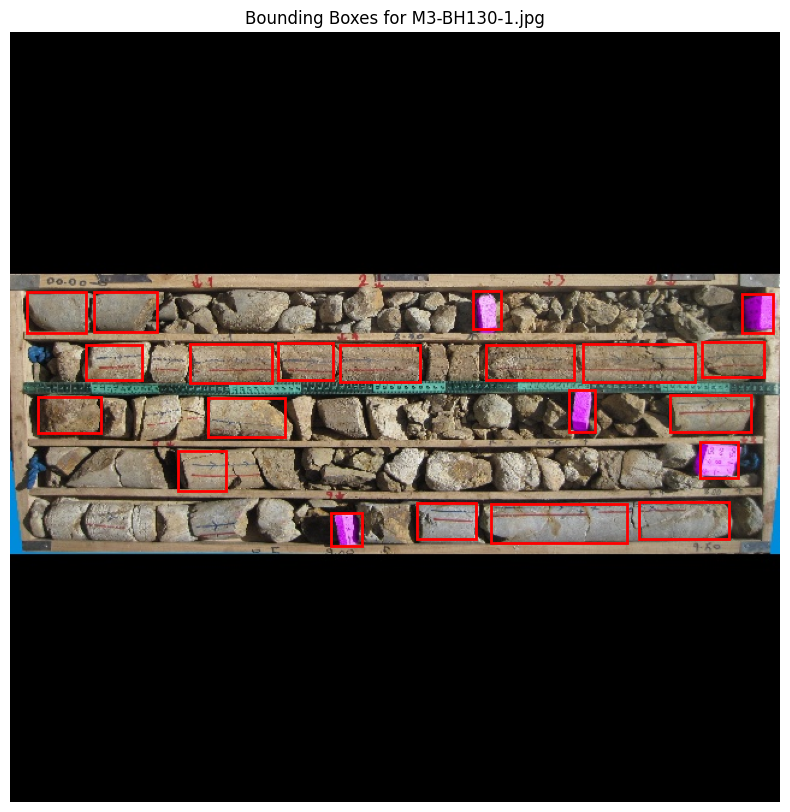

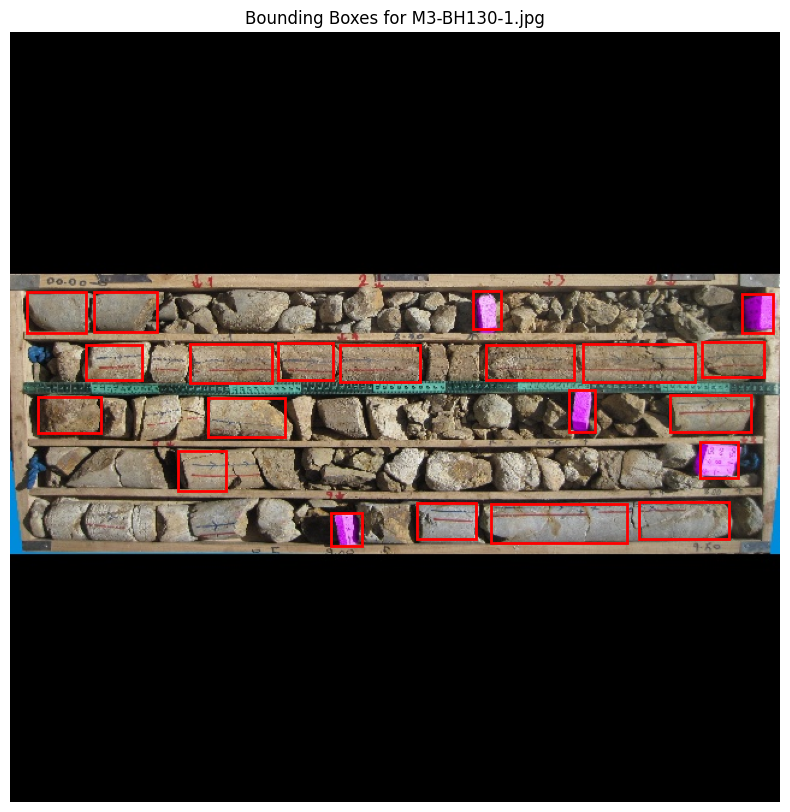

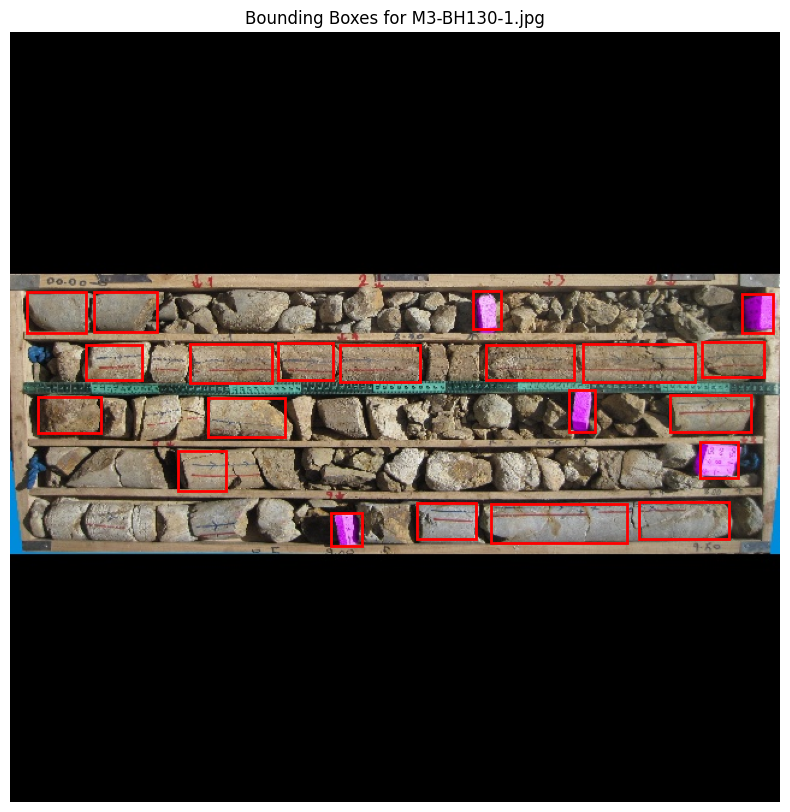

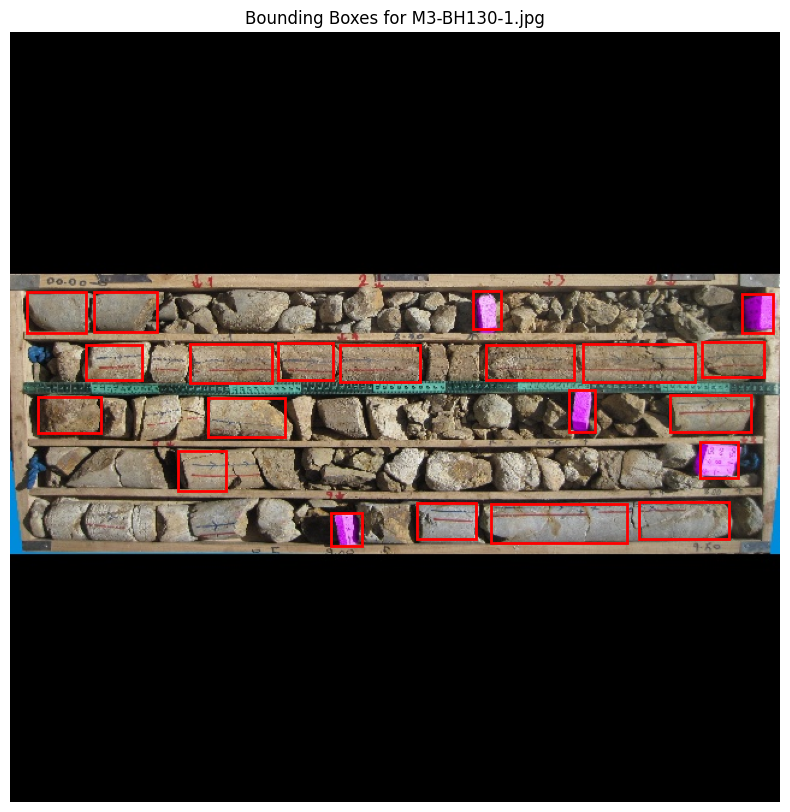

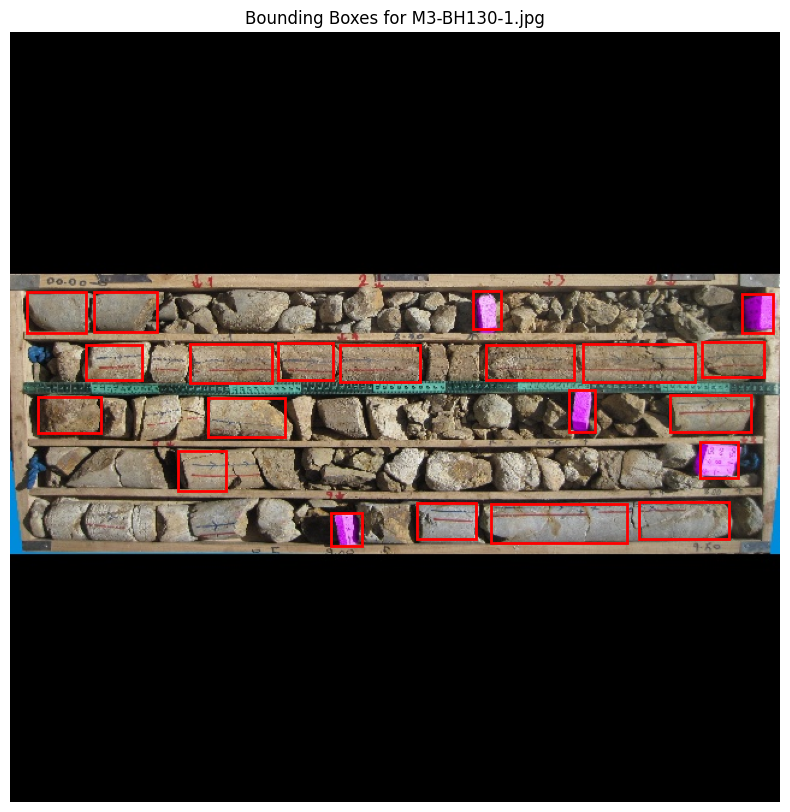

In [ ]:
image_folder = "/content/resized_images"

image_names = df_resized.index[:6]

for image_name in image_names:
    image_path = os.path.join(image_folder, image_name)
    image = Image.open(image_path)

    bboxes = df_resized[df_resized.index == image_name]

    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    ax = plt.gca()

    for _, row in bboxes.iterrows():
        xmin, ymin, width, height = row["xmin"], row["ymin"], row["width"], row["height"]
        ax.add_patch(plt.Rectangle((xmin, ymin), width, height, fill=False, edgecolor='red', linewidth=2))

    plt.title(f"Bounding Boxes for {image_name}")
    plt.axis('off')
    plt.show()

In [ ]:
from pathlib import Path

image_root = "/content/resized_images"


train_images_dir = "/content/yolo_images/train"
test_images_dir = "/content/yolo_images/test"


os.makedirs(train_images_dir, exist_ok=True)
os.makedirs(test_images_dir, exist_ok=True)

image_files = os.listdir(image_root)
train_files = image_files[:int(0.85 * len(image_files))]
test_files = image_files[int(0.85 * len(image_files)):]


for image_name, group in df_resized.groupby(level=0):
    image_path = Path(image_root) / image_name
    image_width = group['image_width'].iloc[0]
    image_height = group['image_height'].iloc[0]


    if image_name in train_files:
        target_image_dir = train_images_dir
    else:
        target_image_dir = test_images_dir


    shutil.copy(image_path, target_image_dir)


    yolo_label_path = os.path.join(target_image_dir, image_name.replace('.jpg', '.txt').replace('.JPG', '.txt'))

    with open(yolo_label_path, 'w') as f:
        for _, row in group.iterrows():
            label = row['label_name']
            xmin = row['xmin']
            ymin = row['ymin']
            width = row['width']
            height = row['height']

            center_x = (xmin + width / 2) / image_width
            center_y = (ymin + height / 2) / image_height
            norm_width = width / image_width
            norm_height = height / image_height

            label_id = 0 if label == 'wood' else 1


            f.write(f"{label_id} {center_x} {center_y} {norm_width} {norm_height}\n")


In [ ]:
import yaml

train_images_dir = "/content/yolo_images/train"
test_images_dir = "/content/yolo_images/test"


num_classes = 2
class_names = ['wood', '+10cm rock']


yaml_data = {
    'train': train_images_dir,
    'val': test_images_dir,
    'nc': num_classes,
    'names': class_names
}


yaml_file_path = "/content/data.yaml"
with open(yaml_file_path, 'w') as yaml_file:
    yaml.dump(yaml_data, yaml_file)



In [ ]:
!pip install opencv-python ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 911.6/911.6 kB 30.6 MB/s eta 0:00:00


In [34]:
from ultralytics import YOLO

model = YOLO("yolo11x.pt")


model.train(
    data="/content/data.yaml",
    epochs=50,
    batch=8,
    imgsz=640,
    project='/content/yolo_project',
    name='train_yolo',
    exist_ok=True
    )

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 109M/109M [00:00<00:00, 334MB/s] 


Ultralytics 8.3.65 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11x.pt, data=/content/data.yaml, epochs=50, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/yolo_project, name=train_yolo, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True

100%|██████████| 755k/755k [00:00<00:00, 18.7MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1      2784  ultralytics.nn.modules.conv.Conv             [3, 96, 3, 2]                 
  1                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  2                  -1  2    389760  ultralytics.nn.modules.block.C3k2            [192, 384, 2, True, 0.25]     
  3                  -1  1   1327872  ultralytics.nn.modules.conv.Conv             [384, 384, 3, 2]              
  4                  -1  2   1553664  ultralytics.nn.modules.block.C3k2            [384, 768, 2, True, 0.25]     
  5                  -1  1   5309952  ultralytics.nn.modules.conv.Conv             [768, 768, 3, 2]              
  6                  -1  2   5022720  ultralytics.nn.modules.block.C3k2            [768, 768, 2, True]           
  7                  -1  1   5309952  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 106MB/s]


AMP: checks passed ✅


train: Scanning /content/yolo_images/train... 265 images, 0 backgrounds, 0 corrupt: 100%|██████████| 265/265 [00:00<00:00, 1988.31it/s]

train: New cache created: /content/yolo_images/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.0 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/yolo_images/test... 47 images, 0 backgrounds, 0 corrupt: 100%|██████████| 47/47 [00:00<00:00, 1853.34it/s]

val: New cache created: /content/yolo_images/test.cache


Plotting labels to /content/yolo_project/train_yolo/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/yolo_project/train_yolo
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      8.78G      1.801      1.919      1.518         12        640: 100%|██████████| 34/34 [00:23<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.24it/s]

                   all         47        705     0.0339       0.41     0.0272     0.0141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      8.94G      1.559      1.505      1.381         26        640: 100%|██████████| 34/34 [00:20<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.01it/s]

                   all         47        705     0.0261      0.421     0.0193    0.00822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      9.12G      1.634       1.42      1.431         15        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.91it/s]

                   all         47        705     0.0606      0.372     0.0439     0.0199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      9.11G      1.552      1.362      1.389         12        640: 100%|██████████| 34/34 [00:21<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.92it/s]

                   all         47        705      0.648      0.653      0.614      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      9.12G      1.595      1.263        1.4         22        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.07it/s]

                   all         47        705      0.558      0.795      0.603      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      8.95G      1.447      1.191      1.346         16        640: 100%|██████████| 34/34 [00:21<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.93it/s]

                   all         47        705      0.684      0.805      0.709      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      9.13G      1.356       1.12       1.28         25        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]

                   all         47        705      0.576      0.831       0.71      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      9.16G      1.327       1.09      1.253         30        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.03it/s]

                   all         47        705      0.726      0.834      0.772       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      9.12G      1.313       1.07      1.265         11        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.02it/s]

                   all         47        705      0.712      0.807      0.776      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      8.94G      1.325      1.074      1.253         40        640: 100%|██████████| 34/34 [00:21<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         47        705      0.739      0.842      0.766      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      9.14G      1.301      1.029      1.225         31        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         47        705      0.735      0.841      0.793      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      9.13G      1.299       1.03      1.222         28        640: 100%|██████████| 34/34 [00:20<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]

                   all         47        705      0.733      0.864      0.804      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      9.13G      1.299      1.044      1.245         12        640: 100%|██████████| 34/34 [00:20<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         47        705      0.748      0.847      0.806      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      8.92G      1.275      1.018      1.226         14        640: 100%|██████████| 34/34 [00:20<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.12it/s]

                   all         47        705      0.754      0.829      0.802      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      9.13G      1.247     0.9965      1.204         26        640: 100%|██████████| 34/34 [00:21<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.09it/s]

                   all         47        705      0.763      0.863      0.826      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      9.13G      1.237     0.9746      1.219         11        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.01it/s]

                   all         47        705      0.762      0.861      0.843      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      9.12G      1.216     0.9776      1.172         10        640: 100%|██████████| 34/34 [00:20<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.11it/s]

                   all         47        705      0.772      0.845      0.808      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      8.95G      1.246     0.9481      1.205         19        640: 100%|██████████| 34/34 [00:20<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]

                   all         47        705      0.761      0.842      0.821      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      9.15G      1.218     0.9588      1.189         28        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]

                   all         47        705      0.751      0.838      0.774      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      9.12G      1.213      0.984      1.185         22        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         47        705      0.753      0.866      0.817      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      9.14G      1.175     0.9338      1.167         10        640: 100%|██████████| 34/34 [00:21<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]

                   all         47        705       0.77      0.878       0.84       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      8.92G      1.193     0.9363      1.169         12        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.12it/s]

                   all         47        705      0.792      0.855      0.846      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      9.11G      1.218     0.9233      1.173         23        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.02it/s]

                   all         47        705      0.768      0.863      0.814      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      9.13G      1.167     0.9179      1.159         24        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.04it/s]

                   all         47        705       0.79      0.817      0.843      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      9.14G      1.183     0.9011      1.168         10        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         47        705      0.794      0.832      0.829      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      8.94G      1.186      0.887      1.181         17        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]

                   all         47        705      0.753       0.88      0.829      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      9.14G      1.166     0.8773      1.157         10        640: 100%|██████████| 34/34 [00:20<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.04it/s]

                   all         47        705       0.75      0.849      0.781      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      9.16G      1.175     0.8647      1.154         14        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         47        705      0.786      0.877      0.844      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      9.11G      1.165     0.8505      1.142         43        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         47        705      0.814      0.878      0.868      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         9G      1.145     0.8282      1.149         31        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]

                   all         47        705        0.8      0.883       0.85      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      9.11G       1.17     0.8628      1.162         14        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         47        705      0.787      0.889      0.835      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      9.09G      1.172     0.8355      1.157         21        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.05it/s]

                   all         47        705      0.803      0.875      0.852      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      9.11G      1.158      0.846      1.149         11        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         47        705       0.81      0.863      0.835      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      8.92G      1.147     0.8383      1.133         23        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         47        705      0.818      0.852      0.833      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      9.12G      1.148     0.8212      1.139         18        640: 100%|██████████| 34/34 [00:21<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.02it/s]

                   all         47        705      0.811      0.886      0.844       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      9.14G      1.128     0.8209      1.129         30        640: 100%|██████████| 34/34 [00:21<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.03it/s]

                   all         47        705      0.814       0.88      0.867        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50       9.1G      1.112     0.7962      1.127         15        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.16it/s]

                   all         47        705       0.83      0.876       0.86      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50         9G      1.104     0.7919      1.114         11        640: 100%|██████████| 34/34 [00:21<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.11it/s]

                   all         47        705      0.835      0.861      0.865      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      9.11G      1.115     0.7813      1.124         13        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         47        705      0.804      0.885      0.831      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      9.11G      1.117     0.7842      1.124         20        640: 100%|██████████| 34/34 [00:21<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.01it/s]

                   all         47        705      0.817      0.904       0.86      0.509


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      9.12G      1.114     0.8094      1.145         11        640: 100%|██████████| 34/34 [00:21<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.95it/s]

                   all         47        705      0.826      0.875      0.853      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      8.99G       1.12     0.7982      1.154         15        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]

                   all         47        705      0.782      0.858      0.849      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      9.15G      1.118     0.7962      1.131         16        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.03it/s]

                   all         47        705      0.825      0.865      0.853      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      9.14G      1.124     0.7976      1.137         17        640: 100%|██████████| 34/34 [00:21<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.96it/s]

                   all         47        705      0.835      0.881      0.877      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      9.16G      1.117     0.7927      1.146         16        640: 100%|██████████| 34/34 [00:21<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.95it/s]

                   all         47        705      0.831      0.888      0.868      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50         9G      1.082     0.7612       1.12         15        640: 100%|██████████| 34/34 [00:20<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.02it/s]

                   all         47        705      0.836      0.884      0.858       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      9.15G      1.091     0.7498      1.116         12        640: 100%|██████████| 34/34 [00:20<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.04it/s]

                   all         47        705      0.818      0.903      0.858      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      9.13G      1.079     0.7386      1.107         12        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.09it/s]

                   all         47        705      0.836      0.903      0.866       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      9.14G      1.074      0.722      1.104         11        640: 100%|██████████| 34/34 [00:20<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.05it/s]

                   all         47        705       0.83      0.887      0.859      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      8.99G      1.069     0.7128      1.108         13        640: 100%|██████████| 34/34 [00:20<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.07it/s]

                   all         47        705      0.836      0.895      0.858      0.523



50 epochs completed in 0.513 hours.
Optimizer stripped from /content/yolo_project/train_yolo/weights/last.pt, 114.4MB
Optimizer stripped from /content/yolo_project/train_yolo/weights/best.pt, 114.4MB

Validating /content/yolo_project/train_yolo/weights/best.pt...
Ultralytics 8.3.65 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11x summary (fused): 464 layers, 56,829,334 parameters, 0 gradients, 194.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]


                   all         47        705      0.833      0.888      0.868      0.525
                  wood         47        130      0.977      0.976      0.976      0.557
            +10cm rock         47        575       0.69        0.8       0.76      0.493
Speed: 0.2ms preprocess, 26.2ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to /content/yolo_project/train_yolo


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b5cf4515bd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804


0: 640x640 3 woods, 21 +10cm rocks, 60.9ms
1: 640x640 2 woods, 19 +10cm rocks, 60.9ms
2: 640x640 2 woods, 27 +10cm rocks, 60.9ms
3: 640x640 4 woods, 10 +10cm rocks, 60.9ms
4: 640x640 2 woods, 15 +10cm rocks, 60.9ms
Speed: 1.8ms preprocess, 60.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


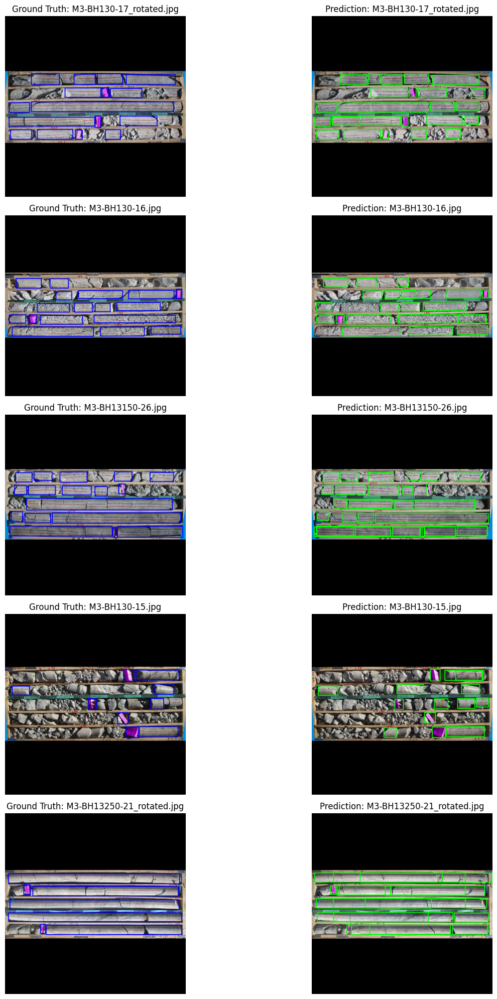

In [35]:
model = YOLO("/content/yolo_project/train_yolo/weights/best.pt")

test_images_dir = "/content/yolo_images/test"
image_files = [f for f in os.listdir(test_images_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
image_files = image_files[:5]
image_paths = [os.path.join(test_images_dir, image_name) for image_name in image_files]

results = model.predict(image_paths)

def draw_boxes(image_path, bboxes, color=(0, 255, 0)):
    image = cv2.imread(image_path)
    for bbox in bboxes:
        xmin, ymin, width, height = bbox
        xmax, ymax = xmin + width, ymin + height
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), color, 2)
    return image

fig, axes = plt.subplots(5, 2, figsize=(15, 20))

for i, image_path in enumerate(image_paths):
    image_name = os.path.basename(image_path)

    if image_name in df_resized.index:
        gt_boxes = df_resized.loc[image_name][['xmin', 'ymin', 'width', 'height']].values.tolist()
        gt_image = draw_boxes(image_path, gt_boxes, color=(255, 0, 0))
        axes[i, 0].imshow(cv2.cvtColor(gt_image, cv2.COLOR_BGR2RGB))
        axes[i, 0].set_title(f"Ground Truth: {image_name}")
        axes[i, 0].axis("off")

    pred_boxes = results[i].boxes.xywh.cpu().numpy()
    pred_boxes = [(int(x - w/2), int(y - h/2), int(w), int(h)) for x, y, w, h in pred_boxes]
    pred_image = draw_boxes(image_path, pred_boxes, color=(0, 255, 0))
    axes[i, 1].imshow(cv2.cvtColor(pred_image, cv2.COLOR_BGR2RGB))
    axes[i, 1].set_title(f"Prediction: {image_name}")
    axes[i, 1].axis("off")

plt.tight_layout()

In [36]:
import os
import cv2

def process_and_save_images(input_folder, output_folder, add_height=25):
    os.makedirs(output_folder, exist_ok=True)

    image_files = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]

    for image_name in image_files:
        image_path = os.path.join(input_folder, image_name)

        image = cv2.imread(image_path)

        height, width, _ = image.shape

        half_height = height // 2

        cropped_image = image[half_height:, :]

        new_height = half_height + add_height
        new_image = cv2.copyMakeBorder(cropped_image, 0, add_height, 0, 0, cv2.BORDER_REPLICATE)

        output_image_path = os.path.join(output_folder, image_name)

        cv2.imwrite(output_image_path, new_image)


input_folder = "/content/output_mine/test-rqd"
output_folder = "/content/test-rqd-processed"
process_and_save_images(input_folder, output_folder)


In [ ]:
output_folder = "/content/test-rqd-processed"

image_files = [f for f in os.listdir(output_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]

selected_images = random.sample(image_files, min(5, len(image_files)))

plt.figure(figsize=(10, 15))

for i, image_file in enumerate(selected_images, 1):
    image_path = os.path.join(output_folder, image_file)
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(5, 1, i)
    plt.imshow(img)
    plt.title(f'{i}: {image_file}')
    plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
from pathlib import Path

def resize_images_for_yolo(input_folder, output_folder, target_size=(640, 640)):
    Path(output_folder).mkdir(parents=True, exist_ok=True)

    image_files = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]

    for image_file in image_files:
        input_path = os.path.join(input_folder, image_file)
        img = cv2.imread(input_path)

        h, w = img.shape[:2]
        ratio = min(target_size[0]/w, target_size[1]/h)
        new_size = (int(w * ratio), int(h * ratio))
        resized = cv2.resize(img, new_size)

        square_img = np.zeros((target_size[0], target_size[1], 3), dtype=np.uint8)

        y_offset = (target_size[0] - new_size[1]) // 2
        x_offset = (target_size[1] - new_size[0]) // 2
        square_img[y_offset:y_offset+new_size[1], x_offset:x_offset+new_size[0]] = resized

        output_path = os.path.join(output_folder, f"resized_{image_file}")
        cv2.imwrite(output_path, square_img)

input_folder = "/content/test-rqd-processed"
output_folder = "/content/test-rqd-resized"

resize_images_for_yolo(input_folder, output_folder)

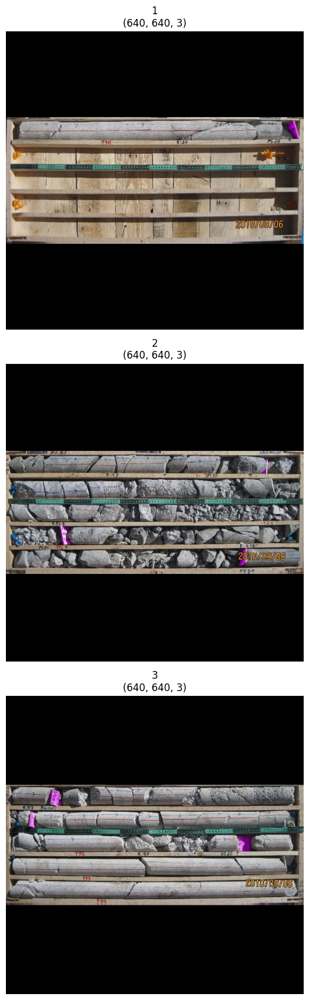

In [39]:
output_folder = "/content/test-rqd-resized"

def show_sample_images(folder, num_samples=3):
    image_files = [f for f in os.listdir(folder) if f.startswith('resized_')]
    samples = random.sample(image_files, min(num_samples, len(image_files)))

    plt.figure(figsize=(10, 17))
    for i, image_file in enumerate(samples):
        img = cv2.imread(os.path.join(folder, image_file))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.subplot(num_samples, 1, i+1)
        plt.imshow(img)
        plt.title(f'{i+1}\n{img.shape}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

show_sample_images(output_folder)

In [40]:
def counter_images(folder_path):

    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif'))]

    num_images = len(image_files)
    print(f'{folder_path}:{num_images}')

In [41]:
path1 = '/content/output_mine/test-rqd'
path2 = '/content/test-rqd-processed'
path3 = '/content/test-rqd-resized'
counter_images(path1)
counter_images(path2)
counter_images(path3)

/content/output_mine/test-rqd:48
/content/test-rqd-processed:48
/content/test-rqd-resized:48



0: 640x640 2 woods, 15 +10cm rocks, 80.8ms
Speed: 1.7ms preprocess, 80.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 5 woods, 19 +10cm rocks, 80.7ms
Speed: 1.7ms preprocess, 80.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 woods, 20 +10cm rocks, 54.8ms
Speed: 1.7ms preprocess, 54.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 4 woods, 4 +10cm rocks, 55.1ms
Speed: 1.7ms preprocess, 55.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 woods, 20 +10cm rocks, 55.7ms
Speed: 1.6ms preprocess, 55.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 4 woods, 8 +10cm rocks, 54.0ms
Speed: 2.5ms preprocess, 54.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 5 woods, 3 +10cm rocks, 55.5ms
Speed: 1.6ms preprocess, 55.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 wo

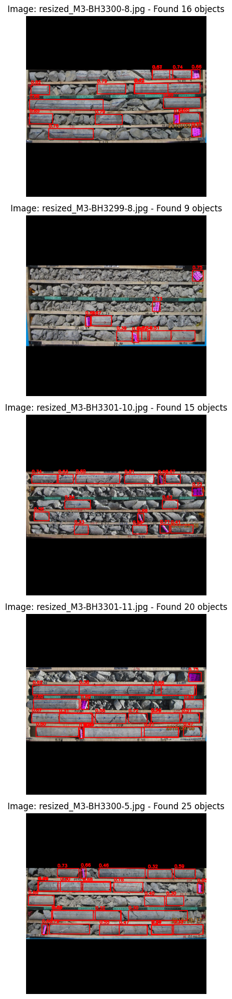

In [135]:
model = YOLO("/content/yolo_project/train_yolo/weights/best.pt")

test_images_dir = "/content/test-rqd-resized"
image_paths = list(Path(test_images_dir).glob("*.jpg"))

predictions = []

for image_path in image_paths:
    img = Image.open(image_path)

    results = model(img, conf=0.30, iou=0.6)

    boxes = results[0].boxes.xyxy.cpu().numpy()
    class_ids = results[0].boxes.cls.cpu().numpy()
    confidences = results[0].boxes.conf.cpu().numpy()

    for box, class_id, conf in zip(boxes, class_ids, confidences):
        xmin, ymin, xmax, ymax = box

        predictions.append({
            "image_name": image_path.name,
            "xmin": int(xmin),
            "ymin": int(ymin),
            "xmax": int(xmax),
            "ymax": int(ymax),
            "class_id": int(class_id),
            "confidence": float(conf)
        })

df_predictions = pd.DataFrame(predictions)

def visualize_predictions(image_names, df_predictions, num_images=5):

    if num_images < len(image_names):
        selected_images = np.random.choice(image_names, num_images, replace=False)
    else:
        selected_images = image_names

    plt.figure(figsize=(15, 4*len(selected_images)))

    for idx, img_name in enumerate(selected_images):
        img_path = Path(test_images_dir) / img_name
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        img_predictions = df_predictions[df_predictions['image_name'] == img_name]

        for _, pred in img_predictions.iterrows():
            cv2.rectangle(img,
                         (int(pred['xmin']), int(pred['ymin'])),
                         (int(pred['xmax']), int(pred['ymax'])),
                         (255, 0, 0), 2)

            label = f"{pred['confidence']:.2f}"
            cv2.putText(img, label,
                       (int(pred['xmin']), int(pred['ymin']-5)),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

        plt.subplot(len(selected_images), 1, idx+1)
        plt.imshow(img)
        plt.title(f"Image: {img_name} - Found {len(img_predictions)} objects")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

unique_images = df_predictions['image_name'].unique()
visualize_predictions(unique_images, df_predictions, num_images=5)

In [136]:
df_predictions

,image_name,xmin,ymin,xmax,ymax,class_id,confidence
0,resized_M3-BH3300-13.jpg,523,299,605,332,1,0.816980
1,resized_M3-BH3300-13.jpg,62,395,241,432,1,0.789821
2,resized_M3-BH3300-13.jpg,138,346,224,380,1,0.784664
3,resized_M3-BH3300-13.jpg,83,197,167,235,1,0.769459
4,resized_M3-BH3300-13.jpg,14,299,137,331,1,0.751381
...,...,...,...,...,...,...,...
786,resized_M3-BH3301-11.jpg,552,351,615,385,1,0.508927
787,resized_M3-BH3301-11.jpg,558,399,620,433,1,0.466896
788,resized_M3-BH3301-11.jpg,188,251,604,287,1,0.383874
789,resized_M3-BH3301-11.jpg,206,401,409,437,1,0.325431


In [137]:
df_predictions['label_name'] = df_predictions['class_id'].map({0: 'wood', 1: '+10cm rock'})
df_predictions = df_predictions.drop(columns=['class_id'])
df_predictions

,image_name,xmin,ymin,xmax,ymax,confidence,label_name
0,resized_M3-BH3300-13.jpg,523,299,605,332,0.816980,+10cm rock
1,resized_M3-BH3300-13.jpg,62,395,241,432,0.789821,+10cm rock
2,resized_M3-BH3300-13.jpg,138,346,224,380,0.784664,+10cm rock
3,resized_M3-BH3300-13.jpg,83,197,167,235,0.769459,+10cm rock
4,resized_M3-BH3300-13.jpg,14,299,137,331,0.751381,+10cm rock
...,...,...,...,...,...,...,...
786,resized_M3-BH3301-11.jpg,552,351,615,385,0.508927,+10cm rock
787,resized_M3-BH3301-11.jpg,558,399,620,433,0.466896,+10cm rock
788,resized_M3-BH3301-11.jpg,188,251,604,287,0.383874,+10cm rock
789,resized_M3-BH3301-11.jpg,206,401,409,437,0.325431,+10cm rock


In [124]:
df_rqd

,from,to
RunId,,
M3-BH3299-1-1,0.00,2.20
M3-BH3299-1-2,2.20,3.30
M3-BH3299-1-3,3.30,4.40
M3-BH3299-2-1,4.40,4.90
M3-BH3299-2-2,4.90,6.50
...,...,...
M3-BH3301-20-1,89.85,90.00
M3-BH3301-20-2,90.00,90.90
M3-BH3301-20-3,90.90,92.60



image 1/1 /content/test-rqd-resized/resized_M3-BH3299-1.jpg: 640x640 2 woods, 9 +10cm rocks, 93.2ms
Speed: 2.8ms preprocess, 93.2ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


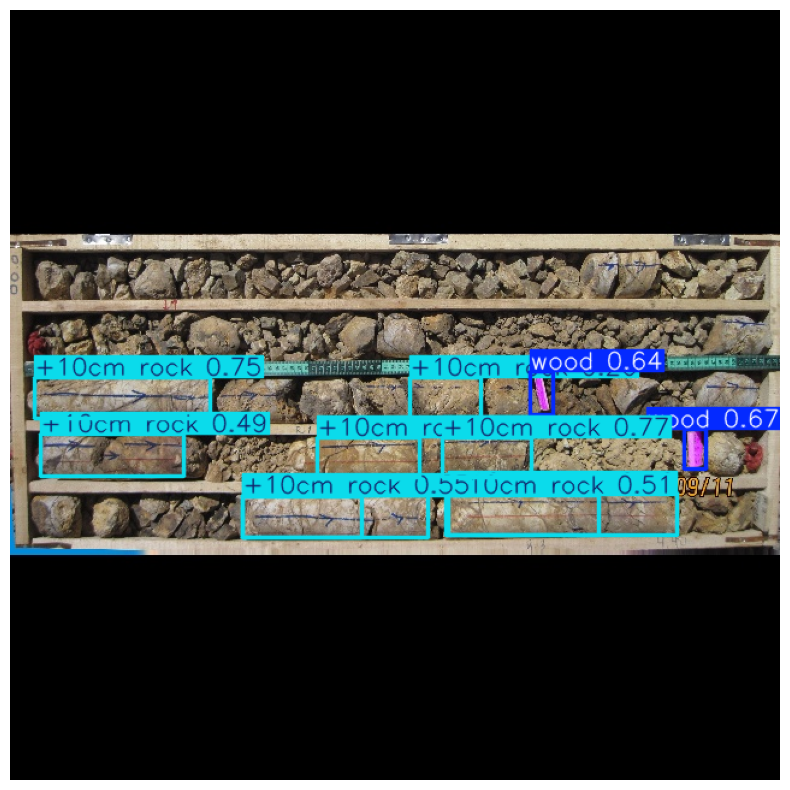

In [85]:
model = YOLO("/content/yolo_project/train_yolo/weights/best.pt")
image_path = '/content/test-rqd-resized/resized_M3-BH3299-1.jpg'
results = model(image_path)
result_image = results[0].plot()

plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [138]:
df_predictions['center_x'] = (df_predictions['xmin'] + df_predictions['xmax']) / 2
df_predictions['center_y'] = (df_predictions['ymin'] + df_predictions['ymax']) / 2

df_predictions = df_predictions.sort_values(by='image_name')
df_predictions

,image_name,xmin,ymin,xmax,ymax,confidence,label_name,center_x,center_y
407,resized_M3-BH3299-1.jpg,359,355,433,388,0.769112,+10cm rock,396.0,371.5
413,resized_M3-BH3299-1.jpg,362,403,489,436,0.506460,+10cm rock,425.5,419.5
412,resized_M3-BH3299-1.jpg,193,403,347,438,0.553025,+10cm rock,270.0,420.5
411,resized_M3-BH3299-1.jpg,255,355,340,388,0.632444,+10cm rock,297.5,371.5
410,resized_M3-BH3299-1.jpg,432,300,451,336,0.635386,wood,441.5,318.0
...,...,...,...,...,...,...,...,...,...
117,resized_M3-BH3301-9.jpg,603,256,631,280,0.688404,wood,617.0,268.0
116,resized_M3-BH3301-9.jpg,558,301,626,332,0.694067,+10cm rock,592.0,316.5
115,resized_M3-BH3301-9.jpg,152,304,208,333,0.744558,+10cm rock,180.0,318.5
114,resized_M3-BH3301-9.jpg,57,303,126,333,0.807544,+10cm rock,91.5,318.0


In [139]:
def range_id(center_y):
    if 0 < center_y <= 235:
        return 0
    elif 235 < center_y <= 280:
        return 1
    elif 280 < center_y <= 330:
        return 2
    elif 330 < center_y <= 380:
        return 3
    elif 380 < center_y <= 450:
        return 4

df_predictions["range_id"] = df_predictions["center_y"].apply(range_id)

sorted_df = df_predictions.sort_values(by=["image_name", "range_id", "center_x"]).reset_index(drop=True)
sorted_df['image_name'] = sorted_df['image_name'].str.replace('resized_', '').str.replace('.jpg', '')
sorted_df

,image_name,xmin,ymin,xmax,ymax,confidence,label_name,center_x,center_y,range_id
0,M3-BH3299-1,20,305,166,339,0.752624,+10cm rock,93.0,322.0,2
1,M3-BH3299-1,432,300,451,336,0.635386,wood,441.5,318.0,2
2,M3-BH3299-1,25,352,144,387,0.491585,+10cm rock,84.5,369.5,3
3,M3-BH3299-1,255,355,340,388,0.632444,+10cm rock,297.5,371.5,3
4,M3-BH3299-1,359,355,433,388,0.769112,+10cm rock,396.0,371.5,3
...,...,...,...,...,...,...,...,...,...,...
786,M3-BH3301-9,75,346,137,376,0.619403,+10cm rock,106.0,361.0,3
787,M3-BH3301-9,433,343,453,374,0.664645,wood,443.0,358.5,3
788,M3-BH3301-9,416,390,488,422,0.334033,+10cm rock,452.0,406.0,4
789,M3-BH3301-9,420,389,589,421,0.403910,+10cm rock,504.5,405.0,4


In [144]:
def merge_bounding_boxes(group_df):
    merged_boxes = []
    current_box = group_df.iloc[0]

    for idx, row in group_df.iterrows():
        if (row['xmin'] <= current_box['xmax'] and row['xmax'] >= current_box['xmin'] and
            row['ymin'] <= current_box['ymax'] and row['ymax'] >= current_box['ymin'] and
            row['label_name'] == current_box['label_name']):

            current_box['xmin'] = min(current_box['xmin'], row['xmin'])
            current_box['ymin'] = min(current_box['ymin'], row['ymin'])
            current_box['xmax'] = max(current_box['xmax'], row['xmax'])
            current_box['ymax'] = max(current_box['ymax'], row['ymax'])
        else:
            merged_boxes.append(current_box)
            current_box = row

    merged_boxes.append(current_box)

    merged_df = pd.DataFrame(merged_boxes)
    return merged_df

result_df = sorted_df.groupby(['image_name', 'range_id'], group_keys=False).apply(merge_bounding_boxes)
result_df = result_df.reset_index(drop=True)
result_df

<ipython-input-144-143fc1179d0d>:23: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  result_df = sorted_df.groupby(['image_name', 'range_id'], group_keys=False).apply(merge_bounding_boxes)


,image_name,xmin,ymin,xmax,ymax,confidence,label_name,center_x,center_y,range_id
0,M3-BH3299-1,20,305,166,339,0.752624,+10cm rock,93.0,322.0,2
1,M3-BH3299-1,432,300,451,336,0.635386,wood,441.5,318.0,2
2,M3-BH3299-1,25,352,144,387,0.491585,+10cm rock,84.5,369.5,3
3,M3-BH3299-1,255,355,340,388,0.632444,+10cm rock,297.5,371.5,3
4,M3-BH3299-1,359,355,433,388,0.769112,+10cm rock,396.0,371.5,3
...,...,...,...,...,...,...,...,...,...,...
653,M3-BH3301-9,152,304,208,333,0.744558,+10cm rock,180.0,318.5,2
654,M3-BH3301-9,558,301,626,332,0.694067,+10cm rock,592.0,316.5,2
655,M3-BH3301-9,75,346,137,376,0.619403,+10cm rock,106.0,361.0,3
656,M3-BH3301-9,433,343,453,374,0.664645,wood,443.0,358.5,3


In [101]:
scale_factor = 110 / 640
result_df['width_cm'] = (result_df['xmax'] - result_df['xmin']) * scale_factor

result = []

for image_name in result_df['image_name'].unique():
    df_image = result_df[result_df['image_name'] == image_name]
    i = 1
    total_width = 0

    for index, row in df_image.iterrows():
        if row['label_name'] == 'wood':
            result.append({
                'RunId': f"{image_name}-{i}",
                'L10cm': total_width,
            })
            i += 1
            total_width = 0
        else:
            total_width += row['width_cm']

    if df_image.iloc[-1]['label_name'] == 'wood':
        result.append({
            'RunId': f"{image_name}-{i}",
            'L10cm': 0,
        })

    elif total_width > 0:
        result.append({
            'RunId': f"{image_name}-{i}",
            'L10cm': total_width,
        })

final_df = pd.DataFrame(result)
final_df

,RunId,L10cm
0,M3-BH3299-1-1,25.093750
1,M3-BH3299-1-2,47.781250
2,M3-BH3299-1-3,59.640625
3,M3-BH3299-2-1,18.046875
4,M3-BH3299-2-2,0.000000
...,...,...
185,M3-BH3301-8-4,20.453125
186,M3-BH3301-8-5,0.000000
187,M3-BH3301-9-1,0.000000
188,M3-BH3301-9-2,43.828125


In [102]:
final_df = final_df.merge(df_rqd, on='RunId', how='left')
df = final_df.dropna()
df = df.assign(Lt = (df['to'] - df['from'])*100)
cols = df.columns.tolist()
cols.remove('L10cm')
cols.append('L10cm')
df = df[cols]
df = df.assign(RQD = (df['L10cm'] / df['Lt'])*100)
def rqd_class(RQD):
    if 0 <= RQD <= 25:
        return 1
    elif 25 < RQD <= 50:
        return 2
    elif 50 < RQD <= 75:
        return 3
    elif 75 < RQD <= 90:
        return 4
    elif 90 < RQD <= 140:
        return 5
df['Class'] = df['RQD'].apply(rqd_class)
df = df.set_index('RunId')
df

,from,to,Lt,L10cm,RQD,Class
RunId,,,,,,
M3-BH3299-1-1,0.00,2.20,220.0,25.093750,11.406250,1
M3-BH3299-1-2,2.20,3.30,110.0,47.781250,43.437500,2
M3-BH3299-1-3,3.30,4.40,110.0,59.640625,54.218750,3
M3-BH3299-2-1,4.40,4.90,50.0,18.046875,36.093750,2
M3-BH3299-2-2,4.90,6.50,160.0,0.000000,0.000000,1
...,...,...,...,...,...,...
M3-BH3301-8-4,35.00,35.85,85.0,20.453125,24.062500,1
M3-BH3301-8-5,35.85,36.25,40.0,0.000000,0.000000,1
M3-BH3301-9-1,36.25,38.30,205.0,0.000000,0.000000,1


In [112]:
df['Class'] = df['Class'].astype(np.int64)


In [113]:
answer = df['Class']
answer

,Class
RunId,
M3-BH3299-1-1,1
M3-BH3299-1-2,2
M3-BH3299-1-3,3
M3-BH3299-2-1,2
M3-BH3299-2-2,1
...,...
M3-BH3301-8-4,1
M3-BH3301-8-5,1
M3-BH3301-9-1,1


In [55]:
answer.to_csv('answer.csv')

In [115]:
model = YOLO("/content/yolo_project/train_yolo/weights/best.pt")
test_images_dir = "/content/test-rqd-resized"
output_dir = "/content/predicted_images"
os.makedirs(output_dir, exist_ok=True)
image_paths = list(Path(test_images_dir).glob("*.jpg"))

predictions = []

for image_path in image_paths:
    img = Image.open(image_path)

    results = model(img, conf=0.30, iou=0.6)

    boxes = results[0].boxes.xyxy.cpu().numpy()
    class_ids = results[0].boxes.cls.cpu().numpy()
    confidences = results[0].boxes.conf.cpu().numpy()

    img_cv = cv2.imread(str(image_path))
    img_cv = cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB)

    for box, class_id, conf in zip(boxes, class_ids, confidences):
        xmin, ymin, xmax, ymax = box

        predictions.append({
            "image_name": image_path.name,
            "xmin": int(xmin),
            "ymin": int(ymin),
            "xmax": int(xmax),
            "ymax": int(ymax),
            "class_id": int(class_id),
            "confidence": float(conf)
        })

        cv2.rectangle(img_cv,
                      (int(xmin), int(ymin)),
                      (int(xmax), int(ymax)),
                      (255, 0, 0), 2)
        label = f"{int(class_id)}: {conf:.2f}"
        cv2.putText(img_cv, label,
                    (int(xmin), int(ymin) - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    output_path = os.path.join(output_dir, image_path.name)
    img_cv = cv2.cvtColor(img_cv, cv2.COLOR_RGB2BGR)
    cv2.imwrite(output_path, img_cv)

df_predictions = pd.DataFrame(predictions)


0: 640x640 2 woods, 15 +10cm rocks, 93.1ms
Speed: 2.4ms preprocess, 93.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 5 woods, 19 +10cm rocks, 50.9ms
Speed: 1.9ms preprocess, 50.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 woods, 20 +10cm rocks, 54.2ms
Speed: 1.8ms preprocess, 54.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 4 woods, 4 +10cm rocks, 52.6ms
Speed: 1.9ms preprocess, 52.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 woods, 20 +10cm rocks, 54.3ms
Speed: 1.8ms preprocess, 54.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 4 woods, 8 +10cm rocks, 53.8ms
Speed: 1.8ms preprocess, 53.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 5 woods, 3 +10cm rocks, 53.9ms
Speed: 1.8ms preprocess, 53.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 wo